# Australian Rain Prediction
We have been approached by the Australian Metreological burea and have been presented with the rask of predicting if it will rain the following day and also give the certainity of the prediction.

Provided to us is historical data of 10 years fromm different places around Australia and the goal is to use the data to train a logistic regression model and make predictions with the validation and test set and also make the mdel be able to produce results that are ggo with test data.

### Objectives
* To download the data from an external source
* To do exploratory data analysis on the data
* To do data preprocessing like :
    1. oulier detection and possible deletions
    2. imputing missing numerical values 
    3. scalling the numerical inputs
    4. one hot encoding categorical inputs

* To split the data into training, validation and test sets
* Train the model 
* Test the model with accuracy score and confusion matrix on
    1. training set, 
    2. validation set 
    3. test set 
    4. dumb models

* Make a funtion to preprocess new inputs into the model and make predictions from the new inputs
* Give a final assement of the weaknesses and strengths of the model we have made using data from a confusion matrix.

### Exploratory Data Analysis and visulisation

In [1]:
#Inporting the ncessary libraries
import pandas as pd
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px

%matplotlib inline

In [2]:
matplotlib.rcParams['font.size'] = 14
matplotlib.rcParams['figure.figsize'] = (10,8)
sns.set_style('darkgrid')
matplotlib.rcParams['figure.facecolor'] = '#000000'


In [3]:
weather_df = pd.read_csv('weatherAUS.csv')

##### Checking for the correct data types for each column

In [4]:
weather_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 145460 entries, 0 to 145459
Data columns (total 23 columns):
 #   Column         Non-Null Count   Dtype  
---  ------         --------------   -----  
 0   Date           145460 non-null  object 
 1   Location       145460 non-null  object 
 2   MinTemp        143975 non-null  float64
 3   MaxTemp        144199 non-null  float64
 4   Rainfall       142199 non-null  float64
 5   Evaporation    82670 non-null   float64
 6   Sunshine       75625 non-null   float64
 7   WindGustDir    135134 non-null  object 
 8   WindGustSpeed  135197 non-null  float64
 9   WindDir9am     134894 non-null  object 
 10  WindDir3pm     141232 non-null  object 
 11  WindSpeed9am   143693 non-null  float64
 12  WindSpeed3pm   142398 non-null  float64
 13  Humidity9am    142806 non-null  float64
 14  Humidity3pm    140953 non-null  float64
 15  Pressure9am    130395 non-null  float64
 16  Pressure3pm    130432 non-null  float64
 17  Cloud9am       89572 non-null

In [5]:
weather_df.sample(5)

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
65273,2012-01-18,MelbourneAirport,22.8,25.3,0.0,15.8,10.6,N,61.0,WNW,...,55.0,62.0,1014.3,1015.7,6.0,5.0,23.7,22.3,No,No
33368,2017-01-25,Sydney,20.6,24.3,17.8,10.2,0.3,SSE,35.0,S,...,68.0,62.0,1020.5,1018.0,7.0,8.0,21.7,23.3,Yes,No
7990,2014-07-24,Cobar,9.6,22.5,0.0,4.0,NaN,N,35.0,NE,...,62.0,19.0,1018.3,1014.1,7.0,4.0,11.6,21.2,No,No
108364,2016-12-01,Woomera,16.1,35.0,0.0,11.4,NaN,SSW,56.0,SE,...,39.0,18.0,1008.3,1006.1,3.0,4.0,23.3,33.8,No,No
145223,2016-11-01,Uluru,16.6,28.6,0.0,NaN,NaN,E,43.0,ESE,...,29.0,22.0,1015.1,1012.3,8.0,7.0,20.6,26.6,No,No


#### We correct only the date object which has a wrong datatype.

In [6]:
weather_df['Date'] = pd.to_datetime(weather_df['Date'])

In [7]:
weather_df.Date.info()

<class 'pandas.core.series.Series'>
RangeIndex: 145460 entries, 0 to 145459
Series name: Date
Non-Null Count   Dtype         
--------------   -----         
145460 non-null  datetime64[ns]
dtypes: datetime64[ns](1)
memory usage: 1.1 MB


#### Anomaly/ outlier detection from the data

In [8]:
weather_df.describe()

,Date,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm
count,145460,143975.000000,144199.000000,142199.000000,82670.000000,75625.000000,135197.000000,143693.000000,142398.000000,142806.000000,140953.000000,130395.00000,130432.000000,89572.000000,86102.000000,143693.000000,141851.00000
mean,2013-04-04 21:08:51.907053568,12.194034,23.221348,2.360918,5.468232,7.611178,40.035230,14.043426,18.662657,68.880831,51.539116,1017.64994,1015.255889,4.447461,4.509930,16.990631,21.68339
min,2007-11-01 00:00:00,-8.500000,-4.800000,0.000000,0.000000,0.000000,6.000000,0.000000,0.000000,0.000000,0.000000,980.50000,977.100000,0.000000,0.000000,-7.200000,-5.40000
25%,2011-01-11 00:00:00,7.600000,17.900000,0.000000,2.600000,4.800000,31.000000,7.000000,13.000000,57.000000,37.000000,1012.90000,1010.400000,1.000000,2.000000,12.300000,16.60000
50%,2013-06-02 00:00:00,12.000000,22.600000,0.000000,4.800000,8.400000,39.000000,13.000000,19.000000,70.000000,52.000000,1017.60000,1015.200000,5.000000,5.000000,16.700000,21.10000
75%,2015-06-14 00:00:00,16.900000,28.200000,0.800000,7.400000,10.600000,48.000000,19.000000,24.000000,83.000000,66.000000,1022.40000,1020.000000,7.000000,7.000000,21.600000,26.40000
max,2017-06-25 00:00:00,33.900000,48.100000,371.000000,145.000000,14.500000,135.000000,130.000000,87.000000,100.000000,100.000000,1041.00000,1039.600000,9.000000,9.000000,40.200000,46.70000
std,NaN,6.398495,7.119049,8.478060,4.193704,3.785483,13.607062,8.915375,8.809800,19.029164,20.795902,7.10653,7.037414,2.887159,2.720357,6.488753,6.93665


No anomalies were detected in the data.

### Data visualisation

We will visualize the data with our target column being rain tomorrow.

#### Data visualisation of the distributions


In [9]:
weather_df.columns

Index(['Date', 'Location', 'MinTemp', 'MaxTemp', 'Rainfall', 'Evaporation',
       'Sunshine', 'WindGustDir', 'WindGustSpeed', 'WindDir9am', 'WindDir3pm',
       'WindSpeed9am', 'WindSpeed3pm', 'Humidity9am', 'Humidity3pm',
       'Pressure9am', 'Pressure3pm', 'Cloud9am', 'Cloud3pm', 'Temp9am',
       'Temp3pm', 'RainToday', 'RainTomorrow'],
      dtype='object')

In [11]:
fig = px.histogram(
    weather_df,
    x='Date',
    color='RainTomorrow',
    marginal='box',
    title='Distribution of rain per year'
)
fig.show()

The rain tomorrow follows a patern that flauctuates up and down giving insight that we may need to include a column of month in the dataframe as it will give a fair approximation of the seasons.

In [12]:
weather_df['month']= pd.DatetimeIndex(weather_df['Date']).month

In [14]:
fig = px.histogram(
    weather_df,
    x='month',
    color='RainTomorrow',
    marginal='box',
    title='Distribution of rain per month'
)
fig.update_layout(bargap= 0.2)
fig.show()

Its is observed that rain tomorrow is increases from Jan to June and is highest in June and the decreases from June to Dec.

No rain tommorrow follows a fairly uniform distribution over every momnth.

In [ ]:
fig = px.histogram(
    weather_df,
    x='Location',
    color='RainTomorrow',
    marginal='box',
    title='Distribution of rain per month'
)
fig.update_layout(bargap= 0.1)
fig.show()

In [31]:

weather_df[weather_df['RainTomorrow'] == 'Yes'].groupby('Location')[['RainTomorrow']].count().sort_values('RainTomorrow',ascending =False).head(5)


,RainTomorrow
Location,
Portland,1095
Cairns,950
Walpole,949
Dartmoor,922
MountGambier,920


Its is observed that the top 5 places with the most rain tommorrow are:
* Portland	
* Cairns	
* Walpole	
* Dartmoor
* MountGambier

And those with the least rain tomorrow are:
* Uluru	
* Woomera	
* Nhil
* AliceSprings
* Katherine

In [32]:

weather_df[weather_df['RainTomorrow'] == 'Yes'].groupby('Location')[['RainTomorrow']].count().sort_values('RainTomorrow',ascending =True).head(5)


,RainTomorrow
Location,
Uluru,116
Woomera,202
Nhil,242
AliceSprings,244
Katherine,265


In [33]:
fig = px.histogram(
    weather_df,
    x='MinTemp',
    color='RainTomorrow',
    marginal='box',
    title='Distribution of rain per month'
)
fig.update_layout(bargap= 0.1)
fig.show()

Min temperature folllows a gausian Distribution
The higher the min temperature above 10 , the higher the chances of it raining tommorow.

In [35]:
fig = px.histogram(
    weather_df,
    x='MaxTemp',
    color='RainTomorrow',
    marginal='box',
    title='Distribution of rain per month'
)
fig.update_layout(bargap= 0.1)
fig.show()

Since the dataframe columns are too many to visualise to get meaningful insights , we shall make a correlation matrix for the numerical columns.

Columns with the highest correlation will bethe ones to be visulised to extract insights from the data.

In [39]:
raintomorrow_dict ={'Yes':1, 'No':0}
weather_df['RainTomorrow_Code']= weather_df['RainTomorrow'].map(raintomorrow_dict)

In [40]:
numeric_cols = weather_df.select_dtypes(include=np.number).columns.tolist()
numeric_cols

['MinTemp',
 'MaxTemp',
 'Rainfall',
 'Evaporation',
 'Sunshine',
 'WindGustSpeed',
 'WindSpeed9am',
 'WindSpeed3pm',
 'Humidity9am',
 'Humidity3pm',
 'Pressure9am',
 'Pressure3pm',
 'Cloud9am',
 'Cloud3pm',
 'Temp9am',
 'Temp3pm',
 'month',
 'RainTomorrow_Code']

<Axes: >

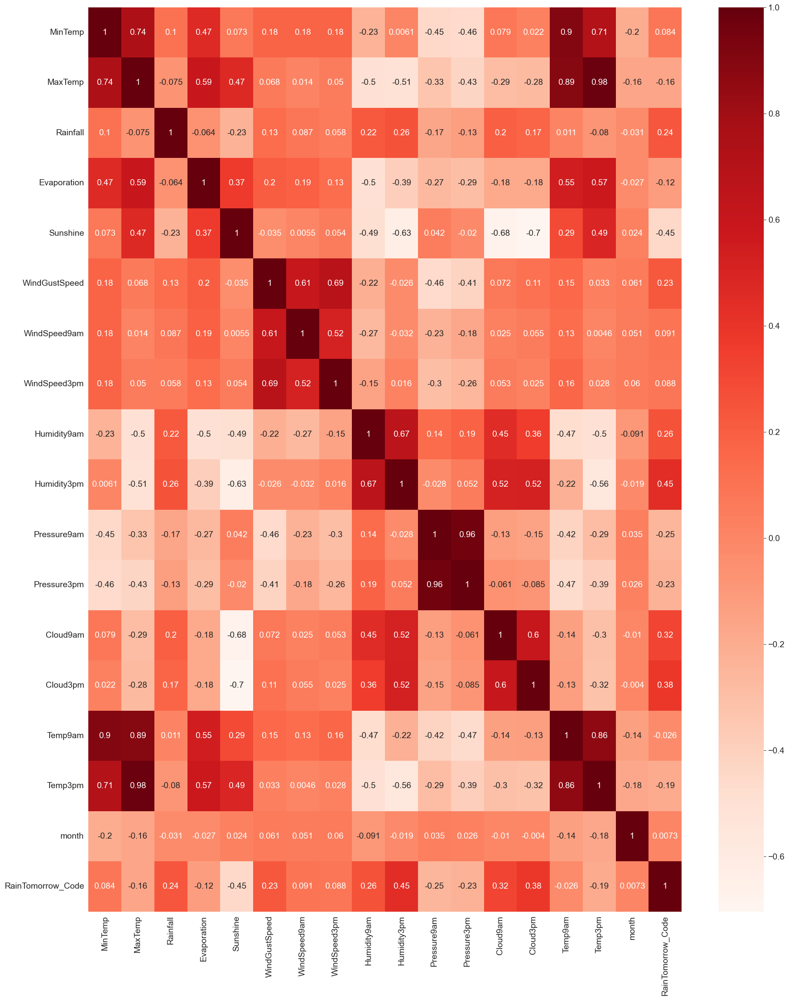

In [52]:
corr_matrix= weather_df[numeric_cols].corr()
plt.figure(figsize = (22,27))
sns.set_style('whitegrid')
sns.heatmap(data =corr_matrix,cmap='Reds',annot=True)


We shall therefore consider the following columns for distributions and relationships of Rain tomrrow:
* Cloud3pm
* cloud9am
* humidity3pm
* sunshine